# Apple Detection using AI

- The algorithm used to detect apple is **YOLOv8** from ultralytics repository
- The model is pretrained on COCO dataset

https://github.com/ultralytics/ultralytics

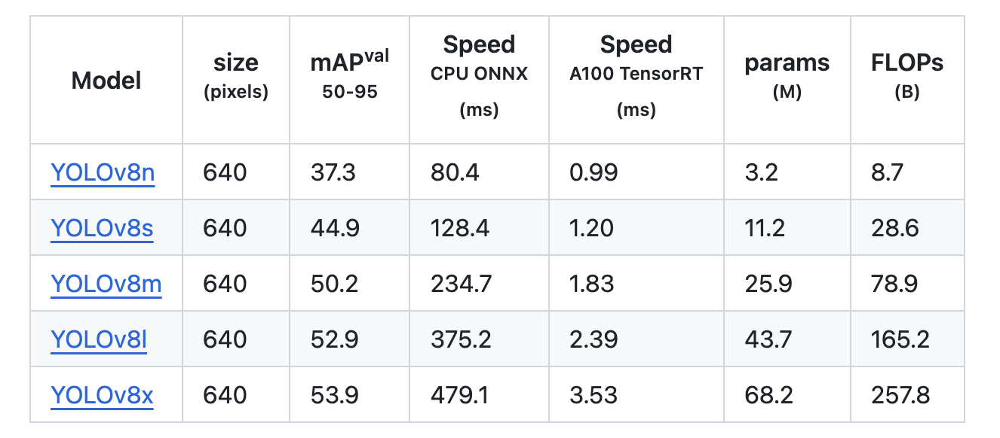

## Install the ultralytics package

In [ ]:
!pip install ultralytics

## Import required libraries

In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

## Load the pre-trained YOLOv8 model

In [ ]:
# we can replace 'yolov8x.pt' with 'yolov8s.pt', 'yolov8m.pt', etc., for different sizes
model = YOLO('yolov8x.pt')  # Pre-trained model on the COCO dataset

100%|██████████| 131M/131M [00:00<00:00, 168MB/s]


## Input image

In [ ]:
# Load the image
img_path = '/content/IMG_6214.JPG'
img = cv2.imread(img_path)

# Convert BGR to RGB
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

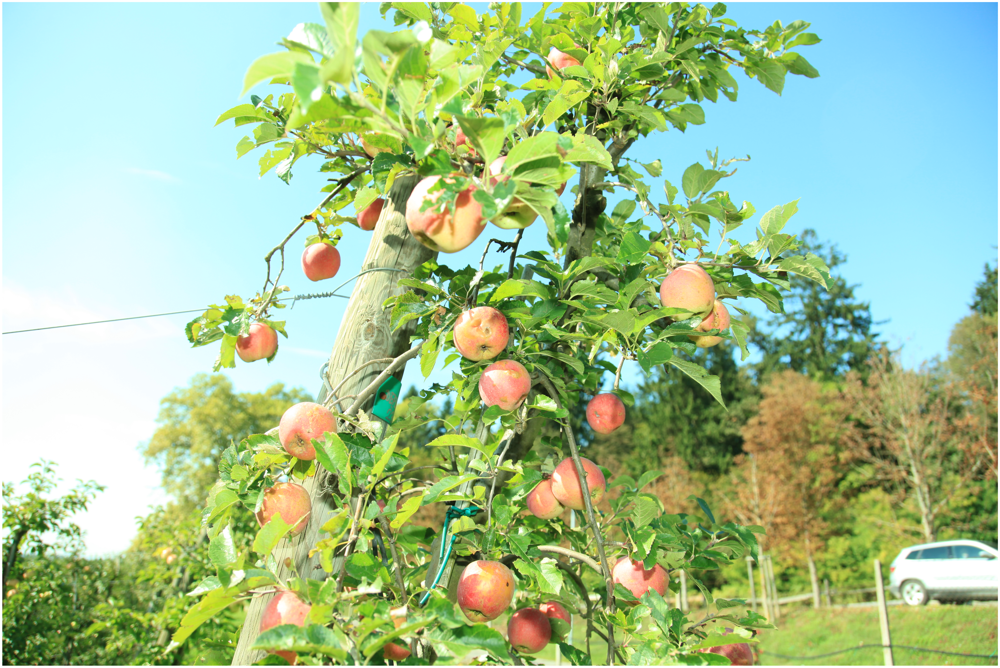

In [ ]:
# Get the dimensions of the image
height, width, _ = img_rgb.shape

# Calculate the figure size in inches (DPI typically 100 in Matplotlib)
dpi = 100.0  # You can adjust this DPI value
fig_size = (width / dpi, height / dpi)

# Create a figure with the correct size
plt.figure(figsize=fig_size)

# Display the image in actual size
plt.imshow(img_rgb)
plt.axis('off')  # Hide the axis
plt.show()


# Inference using the model

In [ ]:
# Perform inference on the image
results = model.predict(img_path)

# Verify and print results to see the detection output
# print(results)



image 1/1 /content/IMG_6214.JPG: 448x640 1 car, 21 apples, 2 oranges, 176.4ms
Speed: 14.4ms preprocess, 176.4ms inference, 1189.2ms postprocess per image at shape (1, 3, 448, 640)


**The model detected:**

* 1 car
* 21 apples
* 2 oranges (False Negative)



**Speed:** 14.4ms preprocess, 176.4ms inference, 1189.2ms postprocess per image

In [ ]:

# Adjust the class index based on your trained model
apple_class_index = 47  # The index for our relevant object 'apple' is 47 based on ultralytics COCO training data

# Process the results
detections = results[0].boxes.data.cpu().numpy()

# List to store apple center coordinates
apple_centers = []





*   the apples detected will be identified with the bounding box in this format



*   the center cordinates can be calculated based on the understanding from the below diagram

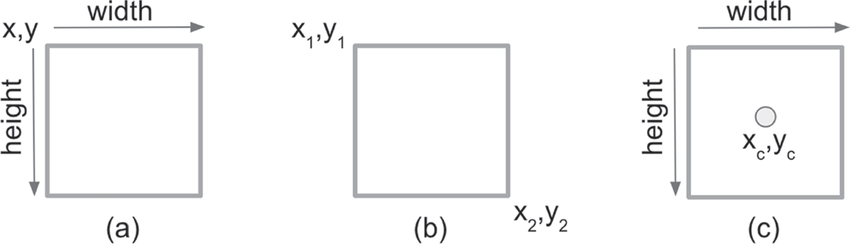






In [ ]:
# Check if there are any detections
apple_count = 0
if len(detections) == 0:
    print("No detections made!")
else:
    # Iterate through detections
    for i, detection in enumerate(detections):
        x1, y1, x2, y2, confidence, class_id = detection[:6]
        if int(class_id) == apple_class_index:
            apple_count += 1
            center_x = int((x1 + x2) / 2)    ## identifiying the centre x cordinate
            center_y = int((y1 + y2) / 2)   ## identifiying the centre y cordinate
            apple_centers.append((center_x, center_y))
            label = f'Apple : {i}'
            x1, y1, x2, y2 = map(int, [x1, y1, x2, y2])
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0 , 0), 2)  # Blue box for apples
            cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
            cv2.circle(img, (center_x, center_y), 5, (255, 0, 0), -1)  # Blue center point

    # save the image to verify the changes
    cv2.imwrite('detected_apples.jpg', img)

print("Number of apples detected: ", apple_count)

Number of apples detected:  21


# Output Image

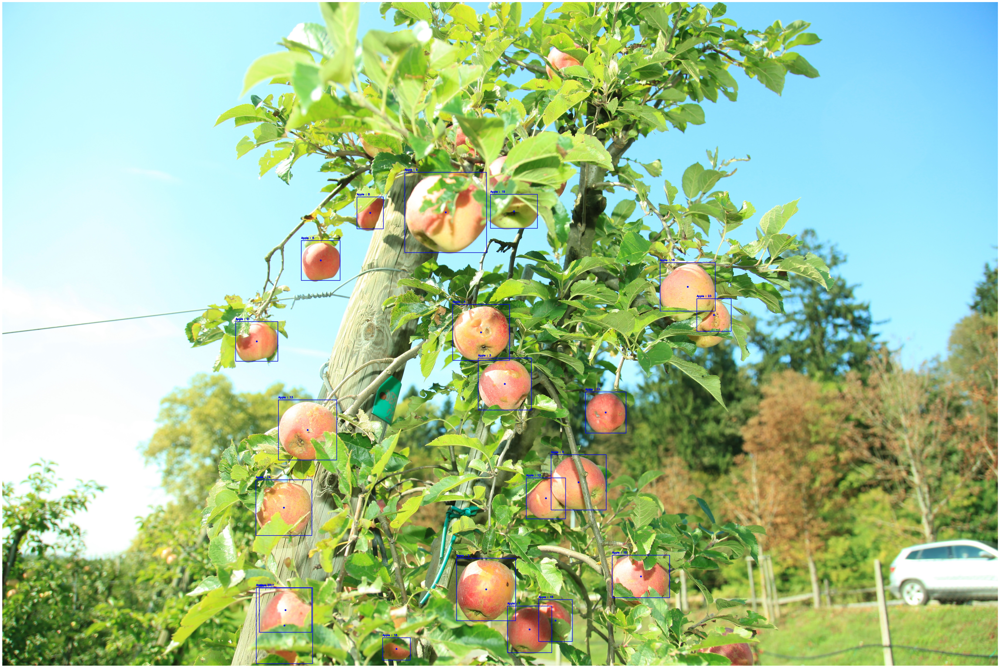

In [ ]:
out_img = cv2.imread('detected_apples.jpg')

# Convert BGR to RGB
out_img_rgb = cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB)

# Display the image
# Get the dimensions of the image
height, width, _ = out_img_rgb.shape

# Calculate the figure size in inches (DPI typically 100 in Matplotlib)
dpi = 100.0  # You can adjust this DPI value
fig_size = (width / dpi, height / dpi)

# Create a figure with the correct size
plt.figure(figsize=fig_size)

# Display the image in actual size
plt.imshow(out_img_rgb)
plt.axis('off')  # Hide the axis
plt.show()

# Center Coordinates for Detected Apples

In [ ]:
# Print the list of apple centers
print("Detected apple centers (x, y):")
for i, center in enumerate(apple_centers):
    print(f"Apple {i}:",center)

Detected apple centers (x, y):
Apple 0: (1435, 1914)
Apple 1: (2729, 3313)
Apple 2: (2834, 2154)
Apple 3: (2700, 1863)
Apple 4: (3250, 2709)
Apple 5: (1796, 1457)
Apple 6: (2974, 3539)
Apple 7: (2075, 1189)
Apple 8: (2501, 1186)
Apple 9: (3602, 3240)
Apple 10: (3403, 2315)
Apple 11: (3066, 2799)
Apple 12: (1722, 2414)
Apple 13: (1588, 2852)
Apple 14: (3120, 3489)
Apple 15: (3866, 1606)
Apple 16: (1597, 3430)
Apple 17: (2223, 3649)
Apple 18: (2886, 1180)
Apple 19: (1591, 3517)
Apple 20: (4014, 1765)
